In [1]:
import os 

import numpy as np
import pandas as pd
import scanpy as sc
import anndata as an
import sklearn.metrics
from matplotlib import pyplot as plt
import seaborn as sns

In [2]:
#adata=sc.read(results_file_post)
#adata.uns['log1p'] = {"base":None}

In [3]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=80, facecolor='white')

The history saving thread hit an unexpected error (OperationalError('database is locked')).History will not be written to the database.
scanpy==1.9.3 anndata==0.10.7 umap==0.5.5 numpy==1.26.4 scipy==1.13.0 pandas==2.2.2 scikit-learn==1.4.2 statsmodels==0.14.1 python-igraph==0.10.4 pynndescent==0.5.12


In [4]:
#%matplotlib inline

In [5]:
writeDir = "write/"

fileName = "mouse_Skin_GSE261766"

resultsFileQC = writeDir + fileName + '_QC.h5ad' 


In [6]:
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=150, fontsize=10, format='png')
sc.settings.figdir = "figures/" + fileName + "/"
figName = fileName

# Read In Data

In [55]:
adata = sc.read_mtx(f'data/{fileName}/logGeneExpr/matrix.mtx').T#,cache=True)
adata

AnnData object with n_obs × n_vars = 57807 × 19937

In [57]:
adata.var = pd.read_table(f'data/{fileName}/logGeneExpr/features.tsv', index_col=0)

In [58]:
adata.obs = pd.read_table(f'data/{fileName}/metadata.csv',sep=",",index_col=0)

/tmp/ipykernel_1365782/3334134615.py:1: DtypeWarning: Columns (66,71) have mixed types. Specify dtype option on import or set low_memory=False.
  adata.obs = pd.read_table(f'data/{fileName}/metadata.csv',sep=",",index_col=0)


# QC

normalizing counts per cell
    finished (0:00:00)


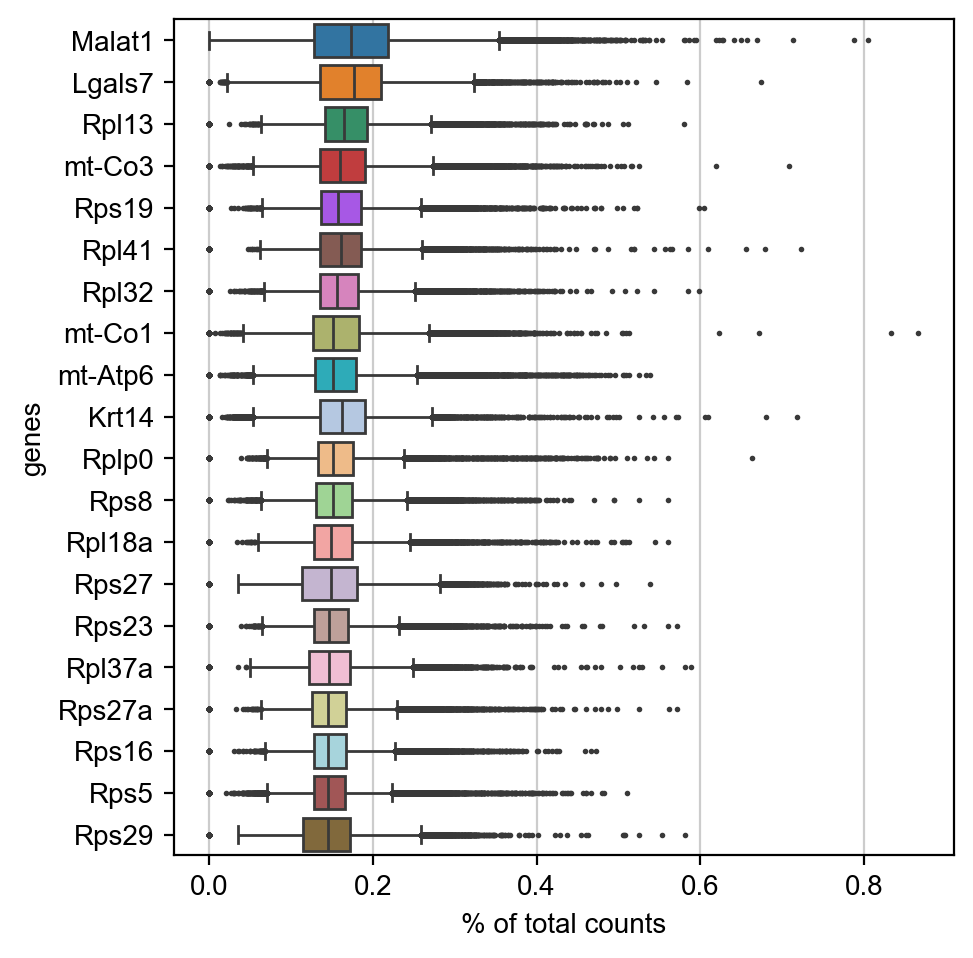

In [59]:
sc.pl.highest_expr_genes(adata, n_top=20, )

/tmp/ipykernel_1365782/3963000175.py:22: UserWarning: FigureCanvasAgg is non-interactive, and thus cannot be shown
  fig.show()


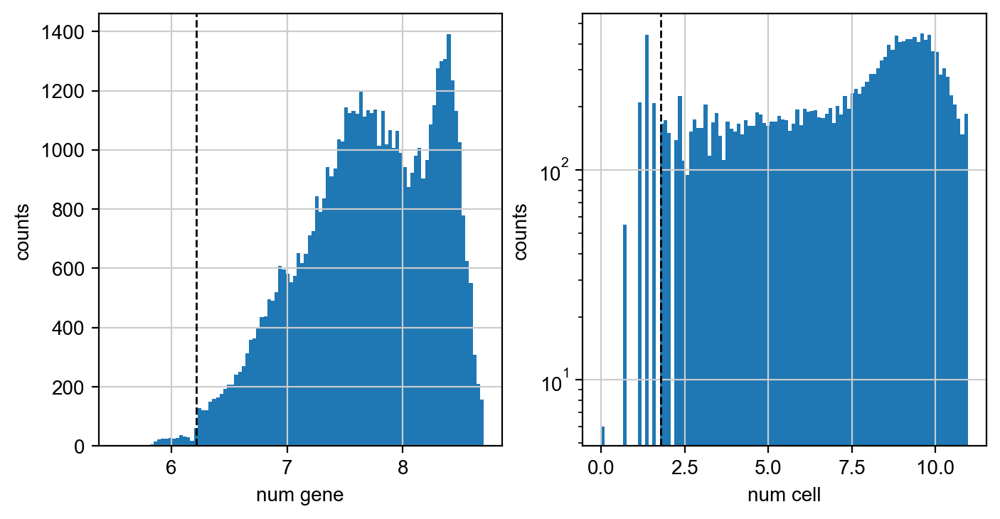

In [60]:
valX = adata.X>0
minGenes=500
minCells=5

fig, axs = plt.subplots(1, 2, figsize=(8, 4))

numCellwExp = valX.sum(axis=1)
axs[0].hist(np.log(numCellwExp), bins=100)#, log=True)
axs[0].axvline(np.log(minGenes), color='k', linestyle='dashed', linewidth=1)
axs[0].set_xlabel('num gene')
axs[0].set_ylabel('counts')

numGeneswExp = valX.sum(axis=0).T
axs[1].hist(np.log(numGeneswExp+1), bins=100, log=True)
axs[1].axvline(np.log(minCells+1), color='k', linestyle='dashed', linewidth=1)
#axs[0,1].axvline(np.log(600), color='k', linestyle='dashed', linewidth=1)
#axs[0,1].axvline(np.log(4000), color='k', linestyle='dashed', linewidth=1)
#axs[0,1].set_title('Gene means counts')
axs[1].set_xlabel('num cell')
axs[1].set_ylabel('counts')

fig.show()

In [61]:
sc.pp.filter_cells(adata, min_genes = minGenes)
sc.pp.filter_genes(adata, min_cells = minCells)

filtered out 316 cells that have less than 500 genes expressed
filtered out 923 genes that are detected in less than 5 cells


In [62]:
adata = adata[:,np.logical_not(adata.var_names=="Malat1")]

## Mito QC

In [63]:
for g in adata.var_names:
    if "MT-" == g[:2]:
        print(g)

In [64]:
adata.var['mt'] = adata.var_names.str.startswith('mt-') 
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], log1p = False, inplace=True)

/tmp/ipykernel_1365782/3426326396.py:1: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['mt'] = adata.var_names.str.startswith('mt-')


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


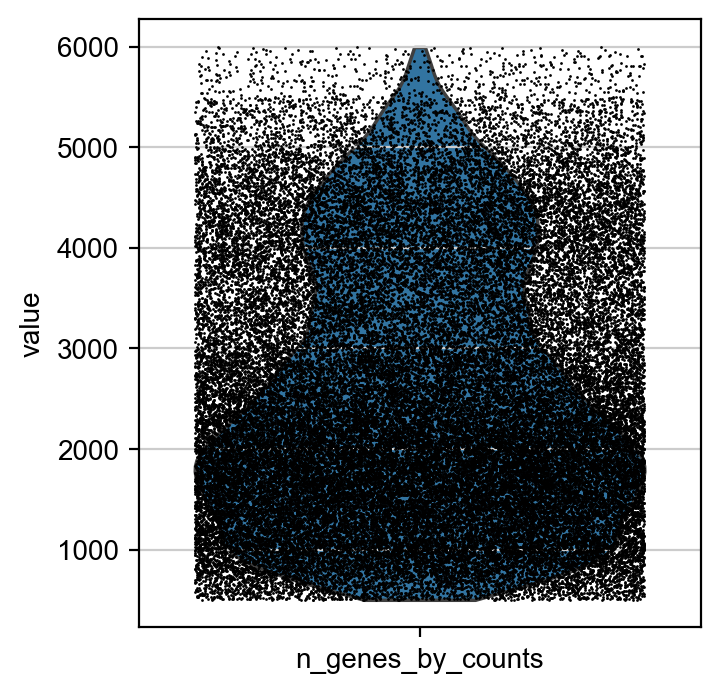

In [65]:
sc.pl.violin(adata, ['n_genes_by_counts'], jitter=0.4)

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


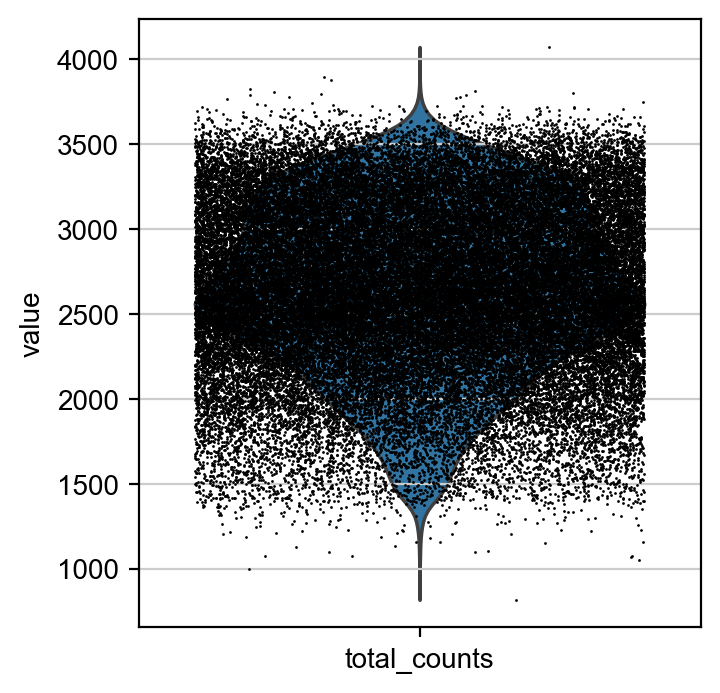

In [66]:
sc.pl.violin(adata, ['total_counts'], jitter=0.4)

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_anndata.py:843: FutureWarning: 

The `scale` parameter has been renamed and will be removed in v0.15.0. Pass `density_norm='width'` for the same effect.
  ax = sns.violinplot(


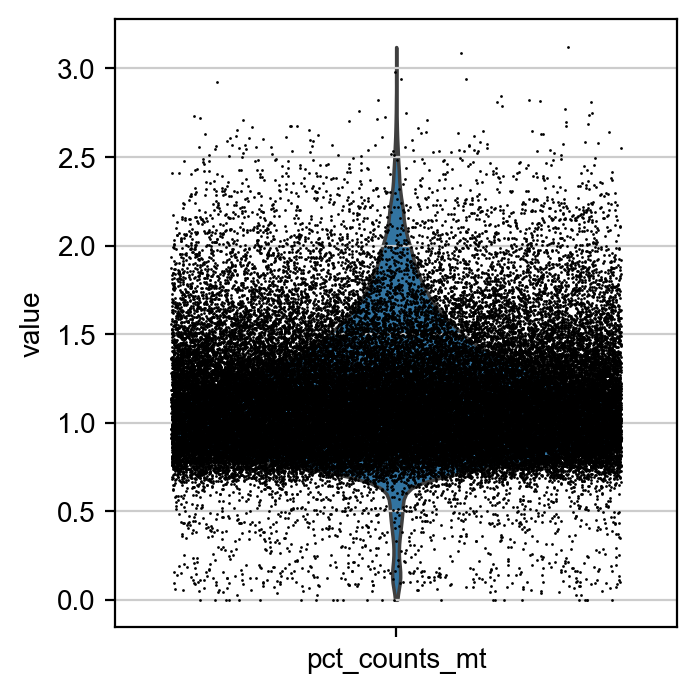

In [67]:
sc.pl.violin(adata, ['pct_counts_mt'], jitter=0.4)

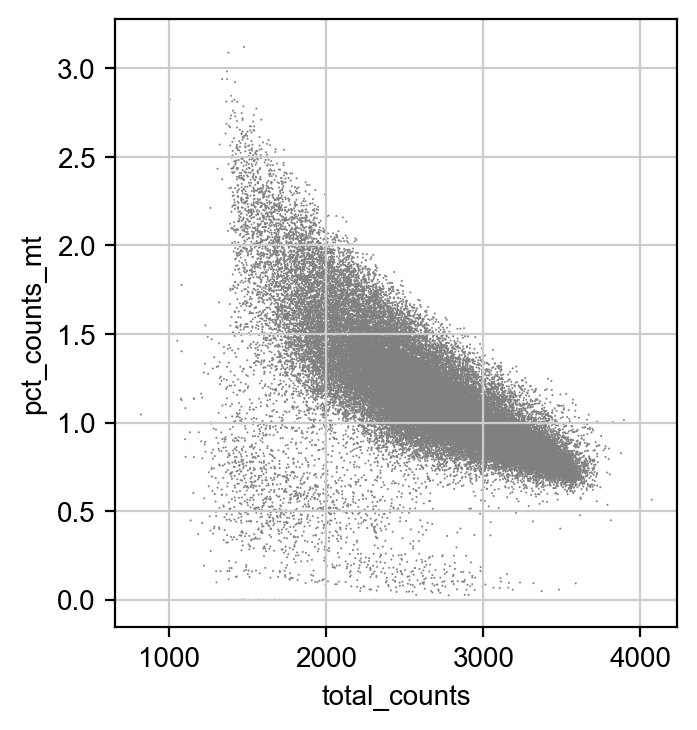

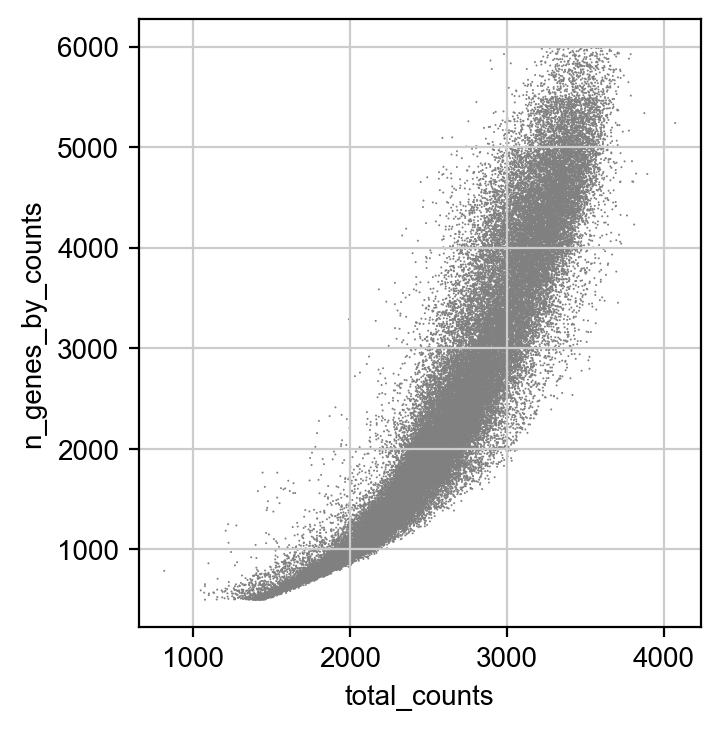

In [68]:
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

remove cells that have too much mito or could be doublets

In [69]:
#adata = adata[adata.obs.n_genes_by_counts < 6000, :]
#adata = adata[adata.obs.total_counts < 40000, :]
#adata = adata[adata.obs.pct_counts_mt < 20, :]

save post QC scanpy

In [74]:
adata.obs = adata.obs[['orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 
           'tissue', 'sorting', 'sample_nom', 'tx_name', 'batch_name', 
           'Size_Factor', 'sample', 'tissue_updated', 'tissue_updated_sorting', 
           'cluster', 'partition', 'cell_type', 'integrated_type_bridge', 
           'integrated_celltype_spike', 'chr1', 'chr2', 'chr3', 'chr4', 
           'chr5', 'chr6', 'chr7', 'chr8', 'chr9', 'chr10', 'chr11', 'chr12', 
           'chr13', 'chr14', 'chr15', 'chr16', 'chr17', 'chr18', 'chr19', 
           'chrMT', 'project.name', 'project.id', 'sample_name', 
           'sample.collection.date', 'Gladstone.Sample.ID', 'sample.ID', 
           'Sample.Info', 'Genotype', 'Mouse.ID', 'Sex', 'Age', 'tissue.name', 
           'tissue.class', 'FACS', 'DMBA.TPA', 'Tamoxifen', 'Chemo', 'Location', 
           'Histology', 'In.vitro.morphology', 'Batch', 'i7', 'i5..reverse.complement.', 
           #'Additional.info', 'Minimum.gene.threshold', 'Maximum.gene.threshold', 
           #'Mitochondrial.threshold', 'pre.QC.N.cells', 'pre.QC.counts.cell', 
           #'pre.QC.counts.gene', 'pre.QC.genes.cell', 'pre.QC.cells.gene', 
           #'post.QC.N.cells', 'post.QC.counts.cell', 'post.QC.counts.gene', 
           #'post.QC.genes.cell', 'post.QC.cells.gene',
           'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 
           'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'pct_counts_mt']]

In [75]:
resultsFileQC

'write/mouse_Skin_GSE261766_QC.h5ad'

In [76]:
adata.write(resultsFileQC)

# Analysis

In [7]:
resultsFile = writeDir + fileName + '.h5ad'       # final output
resultsFileQC = writeDir + fileName + '_QC.h5ad'  # post QC (pre-analysis) 

In [8]:
sc.set_figure_params(scanpy=True, dpi=200, dpi_save=150, fontsize=10, format='png')
sc.settings.figdir = "figures/" + fileName + "/"
figName = fileName

In [43]:
adata = sc.read(resultsFileQC)
adata

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/anndata/__init__.py:55: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.
  warnings.warn(


AnnData object with n_obs × n_vars = 57491 × 19013
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'tissue', 'sorting', 'sample_nom', 'tx_name', 'batch_name', 'Size_Factor', 'sample', 'tissue_updated', 'tissue_updated_sorting', 'cluster', 'partition', 'cell_type', 'integrated_type_bridge', 'integrated_celltype_spike', 'chr1', 'chr2', 'chr3', 'chr4', 'chr5', 'chr6', 'chr7', 'chr8', 'chr9', 'chr10', 'chr11', 'chr12', 'chr13', 'chr14', 'chr15', 'chr16', 'chr17', 'chr18', 'chr19', 'chrMT', 'project.name', 'project.id', 'sample_name', 'sample.collection.date', 'Gladstone.Sample.ID', 'sample.ID', 'Sample.Info', 'Genotype', 'Mouse.ID', 'Sex', 'Age', 'tissue.name', 'tissue.class', 'FACS', 'DMBA.TPA', 'Tamoxifen', 'Chemo', 'Location', 'Histology', 'In.vitro.morphology', 'Batch', 'i7', 'i5..reverse.complement.', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_gene

In [105]:
adata = adata[adata.obs.tissue=="Pap",:] #Pap
resultsFile = writeDir + fileName + '_Pap.h5ad'       # final output

In [106]:
sc.pp.normalize_total(adata,target_sum=1e4)

In [107]:
sc.pp.log1p(adata)

In [108]:
sc.pp.highly_variable_genes(adata)#, flavor = "seurat", n_top_genes=2000)

extracting highly variable genes
    finished (0:00:01)


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:216: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:540: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['hvg'] = {'flavor': flavor}


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:216: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


1552


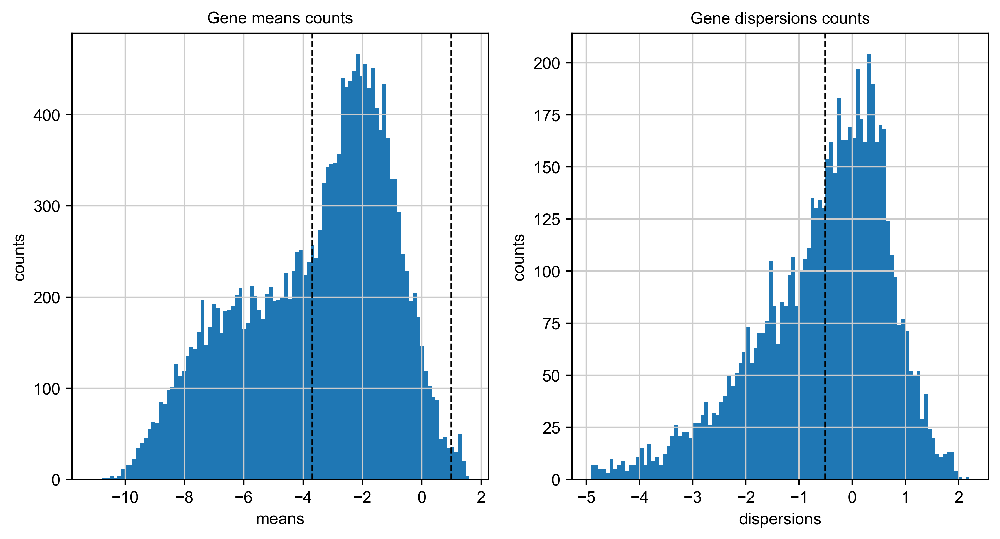

In [112]:
minMean = 0.025
maxMean = 2.7
minDisp = 0.6

fig, axs = plt.subplots(1, 2, figsize=(10, 5))

means = adata.var[["means"]][adata.var[["means"]] > np.exp(-14)]#adata.var[["means"]],
axs[0].hist(np.log(means), bins=100)#, log=True),
axs[0].axvline(np.log(minMean), color='k', linestyle='dashed', linewidth=1)
axs[0].axvline(np.log(maxMean), color='k', linestyle='dashed', linewidth=1)
axs[0].set_title('Gene means counts')
axs[0].set_xlabel('means')
axs[0].set_ylabel('counts')

dispNorm = adata.var[["dispersions_norm"]][adata.var[["dispersions_norm"]] > np.exp(-5)]#adata.var[["means"]],
axs[1].hist(np.log(dispNorm), bins=100)#, log=True),
axs[1].axvline(np.log(minDisp), color='k', linestyle='dashed', linewidth=1)
axs[1].set_title('Gene dispersions counts')
axs[1].set_xlabel('dispersions')
axs[1].set_ylabel('counts')

sc.pp.highly_variable_genes(adata, min_disp=minDisp, min_mean=minMean, max_mean=maxMean)
print(sum(adata.var.highly_variable))

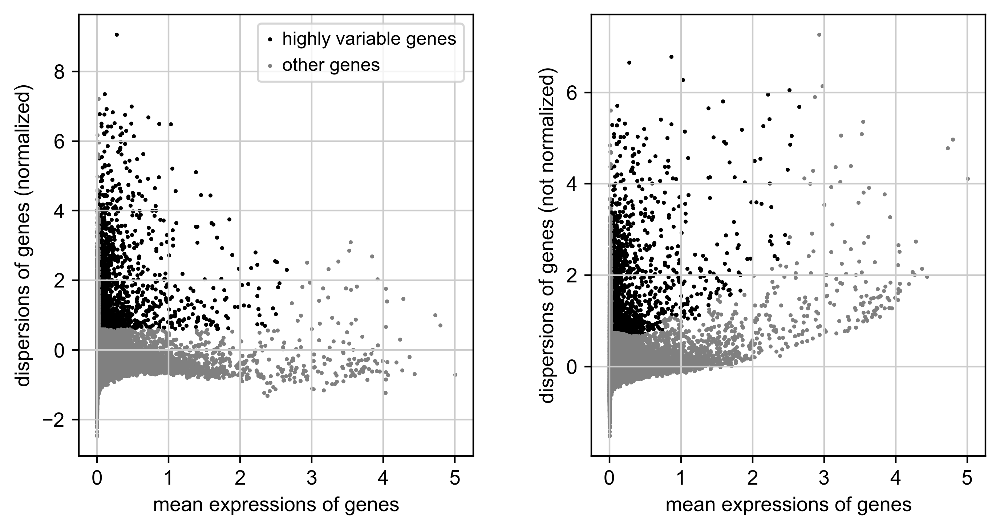

In [113]:
sc.pl.highly_variable_genes(adata)

In [114]:
#for inGene in adata.var[-8:].index.tolist():
#    adata.var.loc[inGene,"highly_variable"] = False

In [115]:
adata.raw = adata

In [116]:
#adata = adata[:, adata.var.highly_variable]
adata = adata[:, np.logical_and(adata.var.highly_variable, np.logical_not(adata.var.mt))]

In [117]:
#sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

In [118]:
#sc.pp.scale(adata, max_value=10)

In [119]:
sc.tl.pca(adata, n_comps = 100, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:02)


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca


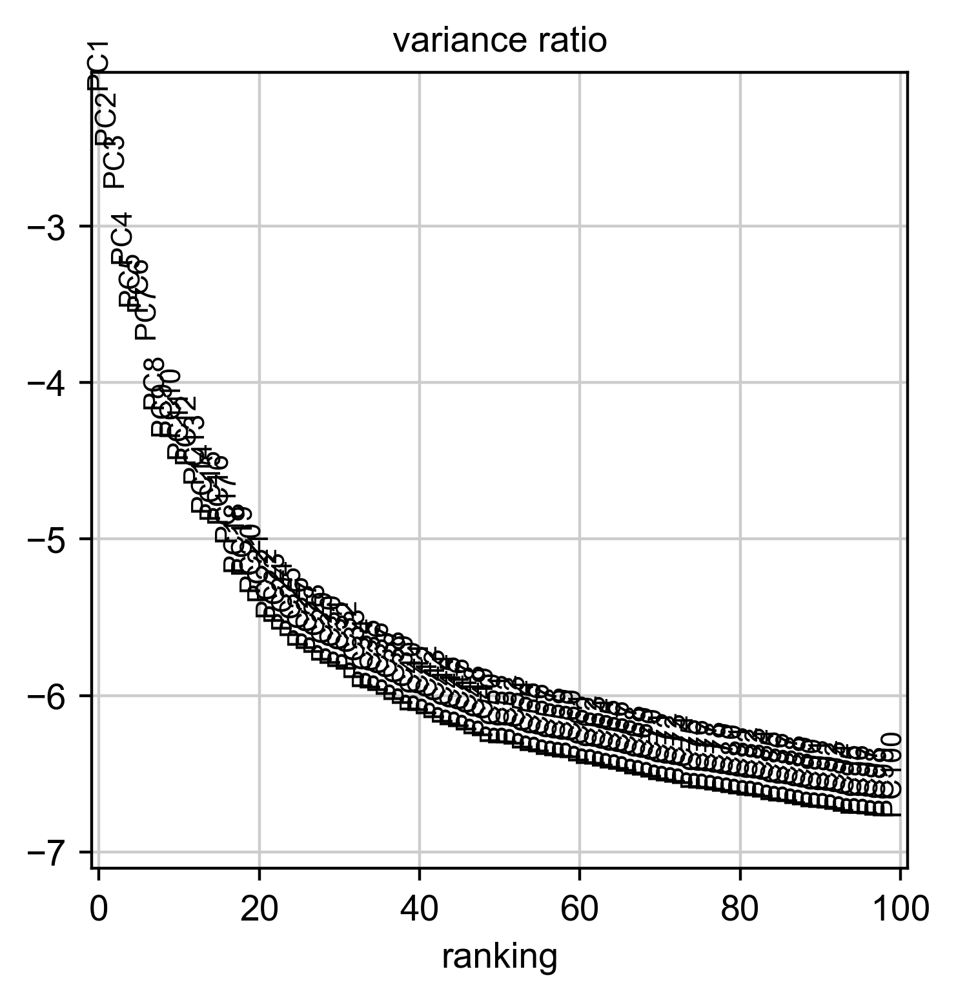

In [120]:
sc.pl.pca_variance_ratio(adata, n_pcs = 100, log=True)

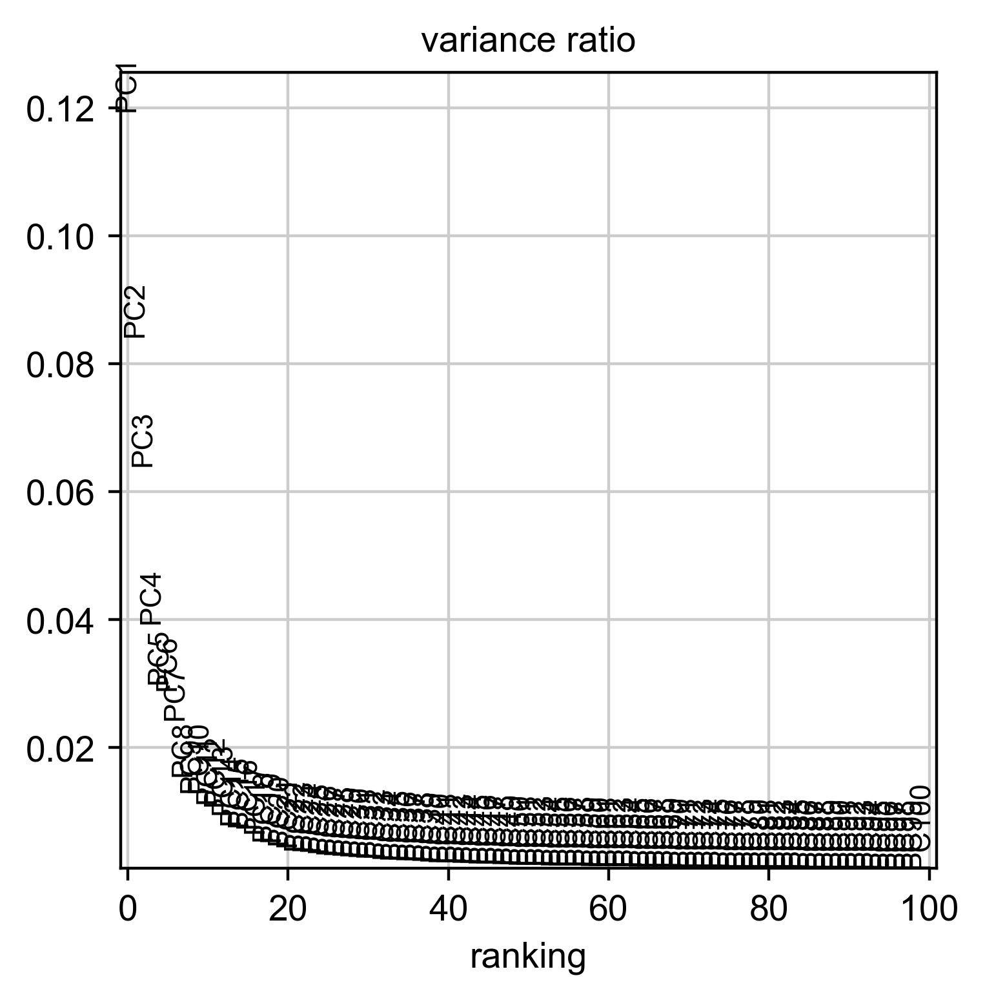

In [121]:
sc.pl.pca_variance_ratio(adata, n_pcs = 100)

In [122]:
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=40)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


In [123]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)


In [124]:
sc.tl.leiden(adata, resolution=0.15)

running Leiden clustering
    finished: found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


In [125]:
adata

AnnData object with n_obs × n_vars = 15280 × 1552
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'tissue', 'sorting', 'sample_nom', 'tx_name', 'batch_name', 'Size_Factor', 'sample', 'tissue_updated', 'tissue_updated_sorting', 'cluster', 'partition', 'cell_type', 'integrated_type_bridge', 'integrated_celltype_spike', 'chr1', 'chr2', 'chr3', 'chr4', 'chr5', 'chr6', 'chr7', 'chr8', 'chr9', 'chr10', 'chr11', 'chr12', 'chr13', 'chr14', 'chr15', 'chr16', 'chr17', 'chr18', 'chr19', 'chrMT', 'project.name', 'project.id', 'sample_name', 'sample.collection.date', 'Gladstone.Sample.ID', 'sample.ID', 'Sample.Info', 'Genotype', 'Mouse.ID', 'Sex', 'Age', 'tissue.name', 'tissue.class', 'FACS', 'DMBA.TPA', 'Tamoxifen', 'Chemo', 'Location', 'Histology', 'In.vitro.morphology', 'Batch', 'i7', 'i5..reverse.complement.', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

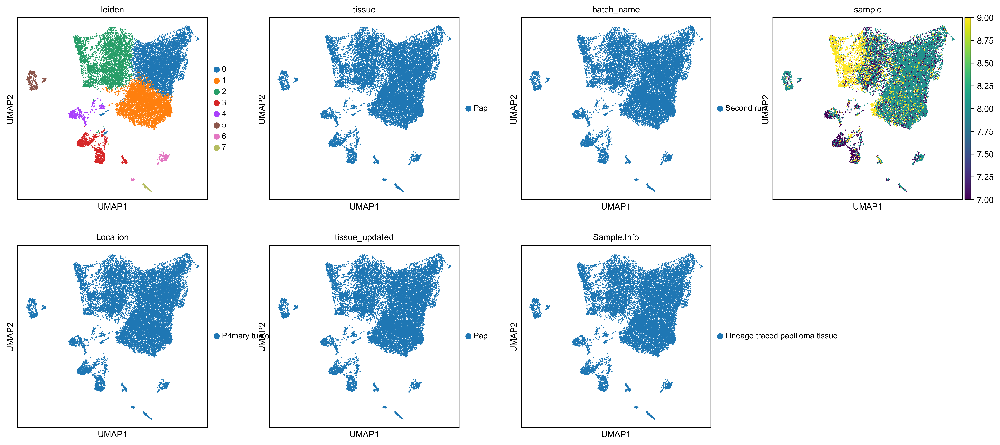

In [126]:
sc.pl.umap(adata, color=["leiden","tissue","batch_name","sample","Location","tissue_updated","Sample.Info"],ncols=4)

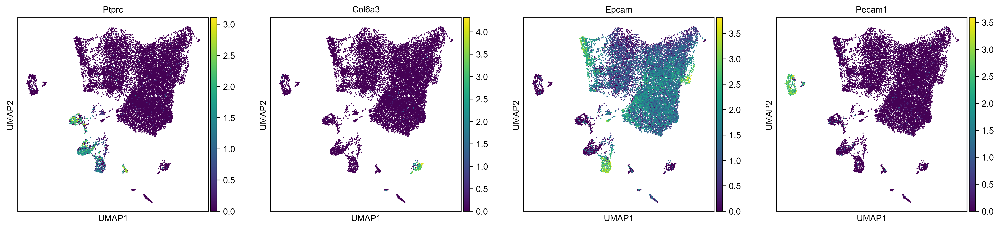

In [127]:
sc.pl.umap(adata, color=["Ptprc","Col6a3","Epcam", "Pecam1"],ncols=4)

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_

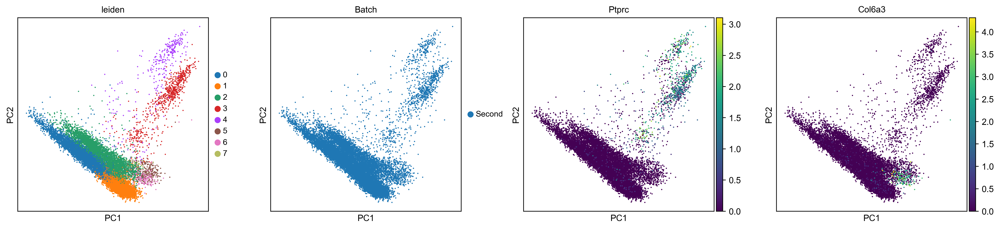

In [128]:
sc.pl.pca(adata, color=["leiden","Batch","Ptprc","Col6a3"],ncols=4)

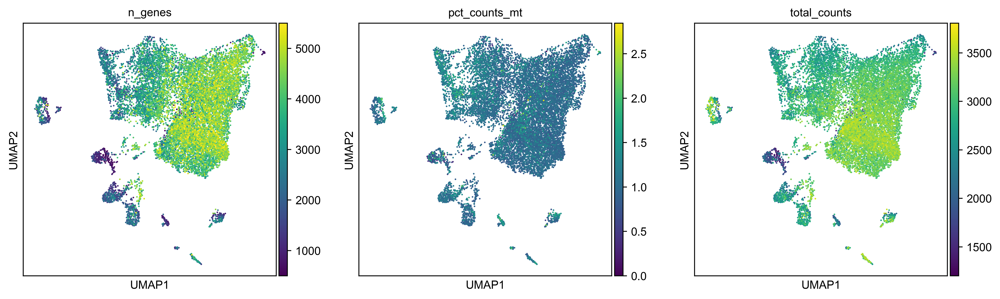

In [129]:
sc.pl.umap(adata, color=["n_genes","pct_counts_mt","total_counts"])

# only tumor

In [130]:
adata = adata[[x in ("0","1","2") for x in adata.obs.leiden]].raw.to_adata()

In [131]:
sc.pp.highly_variable_genes(adata)#, flavor = "seurat", n_top_genes=2000)

extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:216: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:216: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


1718


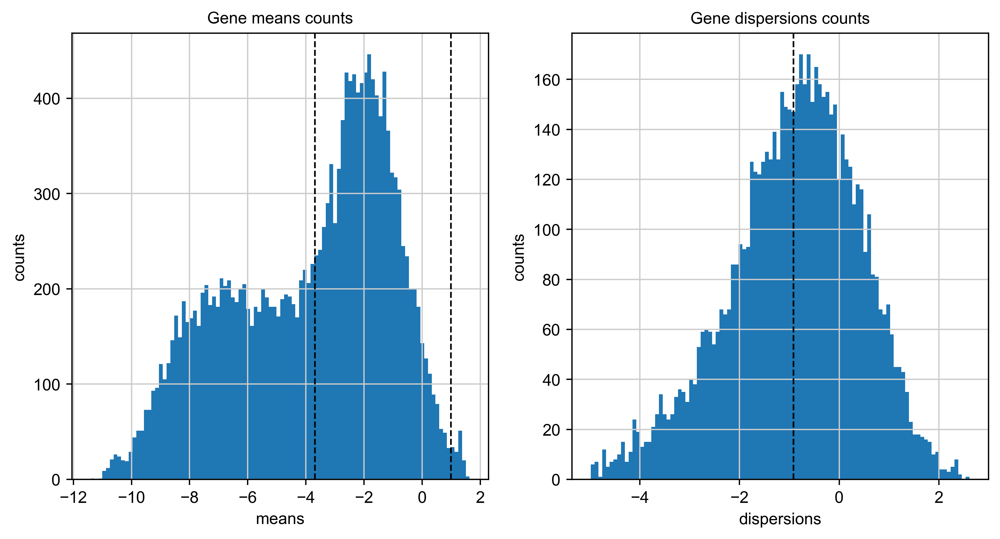

In [134]:
minMean = 0.025
maxMean = 2.7
minDisp = 0.4

fig, axs = plt.subplots(1, 2, figsize=(10, 5))

means = adata.var[["means"]][adata.var[["means"]] > np.exp(-14)]#adata.var[["means"]],
axs[0].hist(np.log(means), bins=100)#, log=True),
axs[0].axvline(np.log(minMean), color='k', linestyle='dashed', linewidth=1)
axs[0].axvline(np.log(maxMean), color='k', linestyle='dashed', linewidth=1)
axs[0].set_title('Gene means counts')
axs[0].set_xlabel('means')
axs[0].set_ylabel('counts')

dispNorm = adata.var[["dispersions_norm"]][adata.var[["dispersions_norm"]] > np.exp(-5)]#adata.var[["means"]],
axs[1].hist(np.log(dispNorm), bins=100)#, log=True),
axs[1].axvline(np.log(minDisp), color='k', linestyle='dashed', linewidth=1)
axs[1].set_title('Gene dispersions counts')
axs[1].set_xlabel('dispersions')
axs[1].set_ylabel('counts')

sc.pp.highly_variable_genes(adata, min_disp=minDisp, min_mean=minMean, max_mean=maxMean)
print(sum(adata.var.highly_variable))

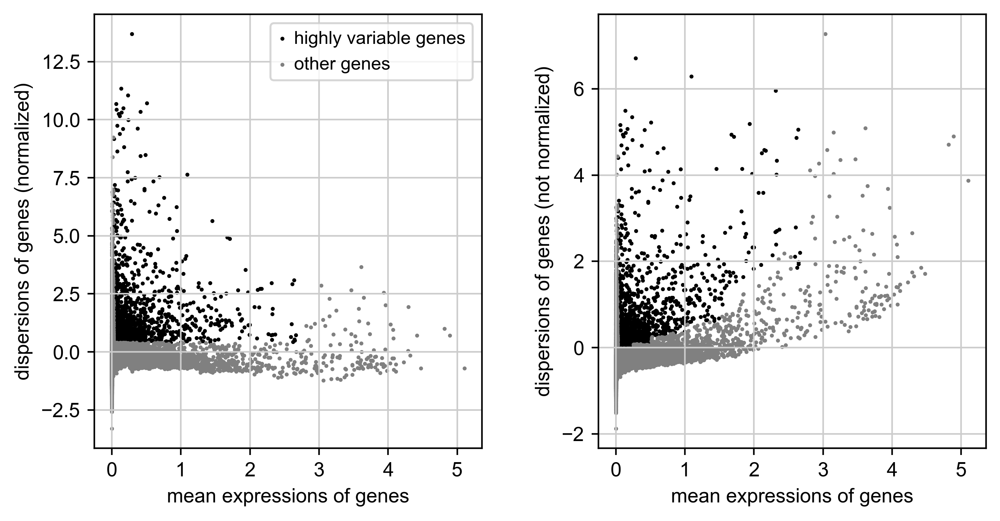

In [135]:
sc.pl.highly_variable_genes(adata)

In [136]:
#for inGene in adata.var[-8:].index.tolist():
#    adata.var.loc[inGene,"highly_variable"] = False

In [137]:
adata.raw = adata

In [138]:
#adata = adata[:, adata.var.highly_variable]
adata = adata[:, np.logical_and(adata.var.highly_variable, np.logical_not(adata.var.mt))]

In [139]:
#sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt'])

In [140]:
#sc.pp.scale(adata, max_value=10)

In [141]:
sc.tl.pca(adata, n_comps = 100, svd_solver='arpack')

computing PCA
    on highly variable genes
    with n_comps=100
    finished (0:00:03)


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/preprocessing/_pca.py:229: ImplicitModificationWarning: Setting element `.obsm['X_pca']` of view, initializing view as actual.
  adata.obsm['X_pca'] = X_pca


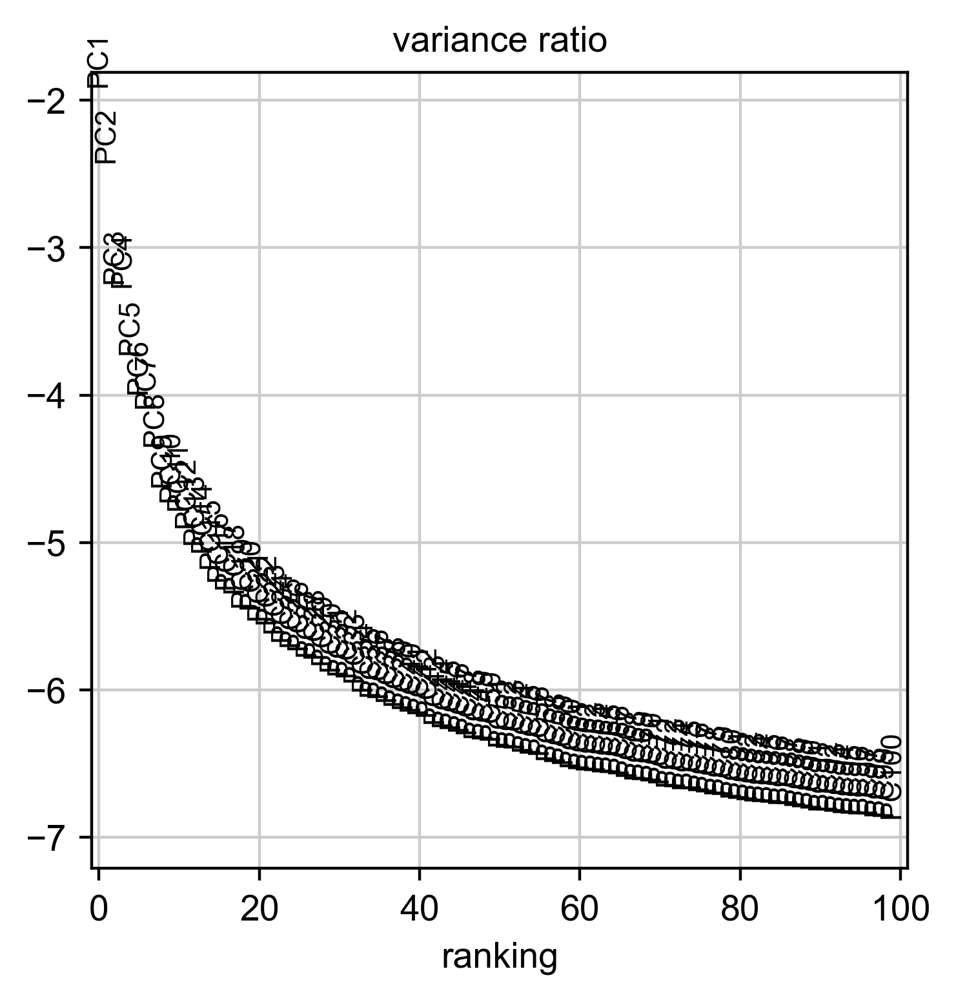

In [142]:
sc.pl.pca_variance_ratio(adata, n_pcs = 100, log=True)

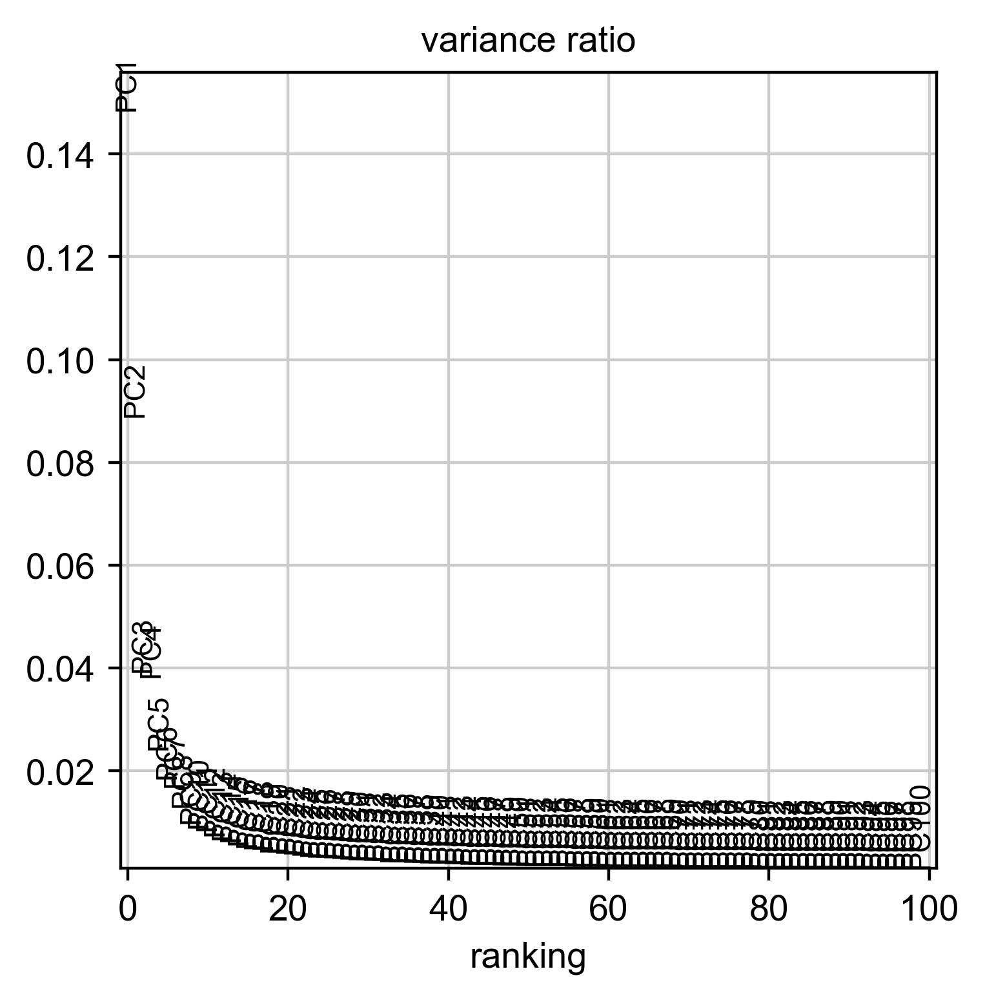

In [143]:
sc.pl.pca_variance_ratio(adata, n_pcs = 100)

In [144]:
sc.pp.neighbors(adata, n_neighbors=20, n_pcs=40)

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:01)


In [145]:
sc.tl.umap(adata)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


In [146]:
sc.tl.leiden(adata, resolution=0.15)

running Leiden clustering
    finished: found 4 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


In [147]:
adata.obs

,orig.ident,nCount_RNA,nFeature_RNA,percent.mt,tissue,sorting,sample_nom,tx_name,batch_name,Size_Factor,...,n_genes,n_genes_by_counts,total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,pct_counts_in_top_200_genes,pct_counts_in_top_500_genes,total_counts_mt,pct_counts_mt,leiden
AAACCTGAGTCGAGTG-1_7,CA_US,23418,3349,9.531130,Pap,Unsorted,Pap Unsorted,Treated,Second run,0.854709,...,3349,3348,2556.118164,8.390692,15.088424,24.744392,42.708690,40.787075,1.595665,0
AAACCTGCAAATCCGT-1_7,CA_US,15120,3308,3.855820,Pap,Unsorted,Pap Unsorted,Treated,Second run,1.550193,...,3308,3307,3030.902100,6.702355,12.282273,20.754126,37.501827,33.423244,1.102749,0
AAACCTGGTCTGATTG-1_7,CA_US,28697,4648,2.066418,Pap,Unsorted,Pap Unsorted,Treated,Second run,1.259261,...,4648,4647,3287.996338,6.102646,11.189860,18.934884,34.314051,26.326052,0.800672,1
AAACCTGTCCAAACTG-1_7,CA_US,19270,3546,2.636222,Pap,Unsorted,Pap Unsorted,Treated,Second run,0.949852,...,3546,3545,2988.184326,6.700765,12.481095,21.228795,38.126167,27.635637,0.924830,0
AAACCTGTCCACGAAT-1_7,CA_US,10913,2874,4.059379,Pap,Unsorted,Pap Unsorted,Treated,Second run,1.377993,...,2874,2873,2947.999268,6.940962,12.585044,20.903345,37.308838,31.565821,1.070754,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGGTTTCGGTTAAC-1_9,CA_US,9053,2297,4.098089,Pap,Lgr6,Pap Lgr6,Treated,Second run,1.114189,...,2297,2296,2576.728760,8.187404,15.005454,24.560337,42.533518,31.791414,1.233790,2
TTTGTCAAGTGACTCT-1_9,CA_US,3437,1121,0.087285,Pap,Lgr6,Pap Lgr6,Treated,Second run,0.672287,...,1121,1120,1978.445679,10.814015,19.332510,31.768544,57.274113,2.275064,0.114992,2
TTTGTCAGTCAATGTC-1_9,CA_US,9138,2888,4.815058,Pap,Lgr6,Pap Lgr6,Treated,Second run,1.361874,...,2888,2887,3164.383301,6.026528,10.846483,18.769013,34.743017,29.955219,0.946637,0
TTTGTCATCAGGTTCA-1_9,CA_US,11942,2785,4.044549,Pap,Lgr6,Pap Lgr6,Treated,Second run,1.313123,...,2785,2784,2754.983398,7.555380,13.731887,22.522667,39.483967,34.517338,1.252905,2


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


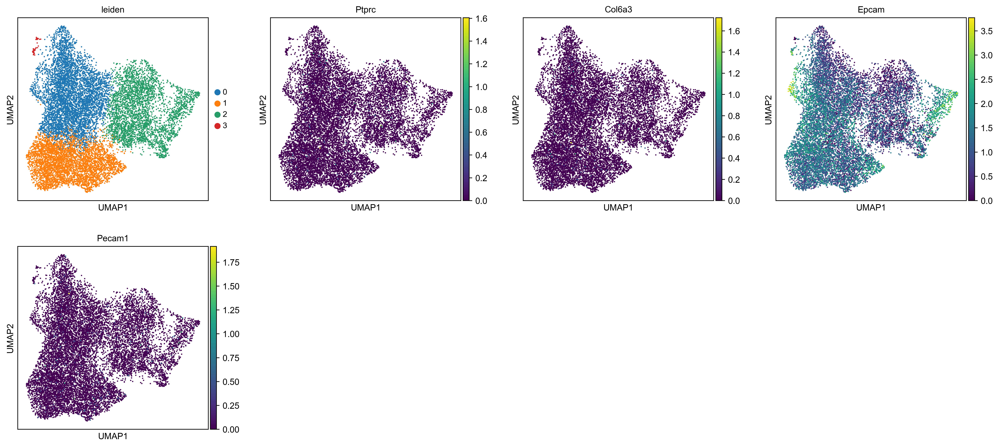

In [149]:
sc.pl.umap(adata, color=["leiden","Ptprc","Col6a3","Epcam", "Pecam1"],ncols=4)

/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


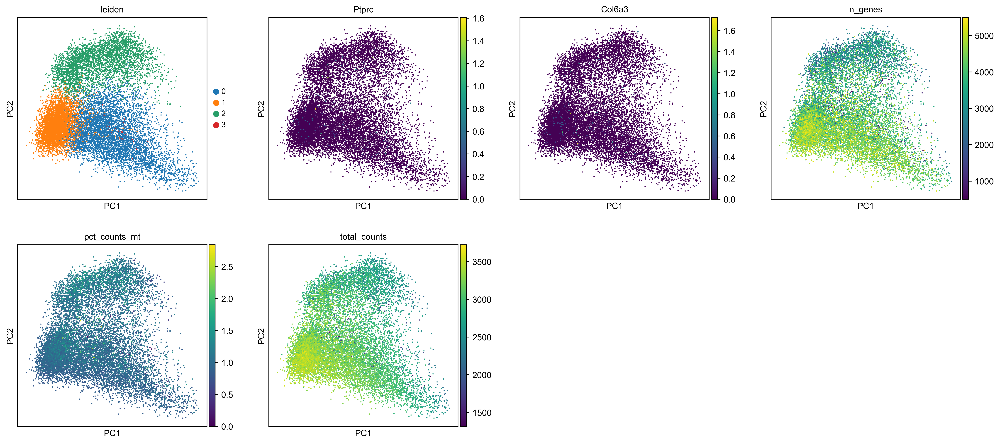

In [150]:
sc.pl.pca(adata, color=["leiden","Ptprc","Col6a3","n_genes","pct_counts_mt","total_counts"],ncols=4)

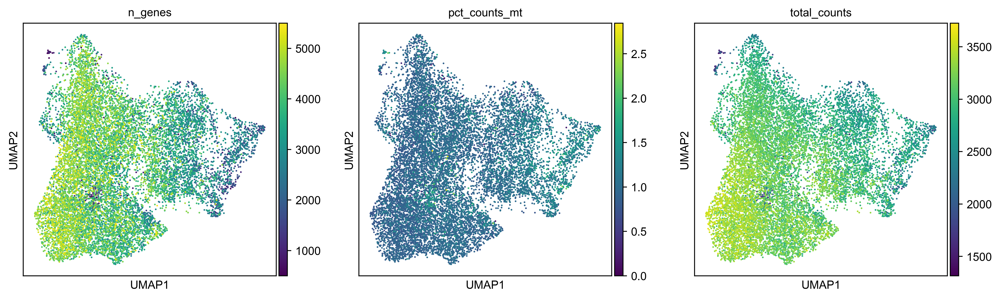

In [151]:
sc.pl.umap(adata, color=["n_genes","pct_counts_mt","total_counts"])

ranking genes


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:01)


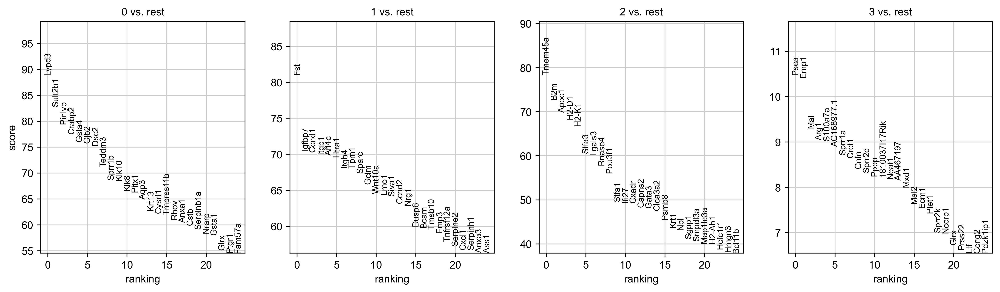

In [152]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon', use_raw=False)
#sc.tl.filter_rank_genes_groups(adata, groupby="leiden", use_raw=False,
#                                   key_added='rank_genes_groups_filtered', 
#                                   min_in_group_fraction=0.25, min_fold_change=1, max_out_group_fraction=0.5, compare_abs=False)
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

In [153]:
pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(15)

,0,1,2,3
0,Lypd3,Fst,Tmem45a,Psca
1,Sult2b1,Igfbp7,B2m,Emp1
2,Pinlyp,Ccnd1,Apoc1,Mal
3,Crabp2,Itgb1,H2-D1,Arg1
4,Gsta4,Arl4c,H2-K1,S100a7a
5,Gjb2,Htra1,Stfa3,AC168977.1
6,Dsc2,Itgb4,Lgals3,Sprr1a
7,Teddm3,Tpm1,Rnase4,Crct1
8,Sprr1b,Sparc,Pou3f1,Cnfn
9,Klk10,Gclm,Stfa1,Sprr2d


    using 'X_pca' with n_pcs = 40
Storing dendrogram info using `.uns['dendrogram_leiden']`


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/tools/_dendrogram.py:133: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  mean_df = rep_df.groupby(level=0).mean()
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/get/get.py:66: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What's New notes for pandas 2.1.0 for details. Specify future_stack=True to adopt the new implementation and silence this warning.
  d = d.stack(level=1).reset_index()
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/get/get.py:66: FutureWarning: The previous implementation of stack is deprecated and will be removed in a future version of pandas. See the What

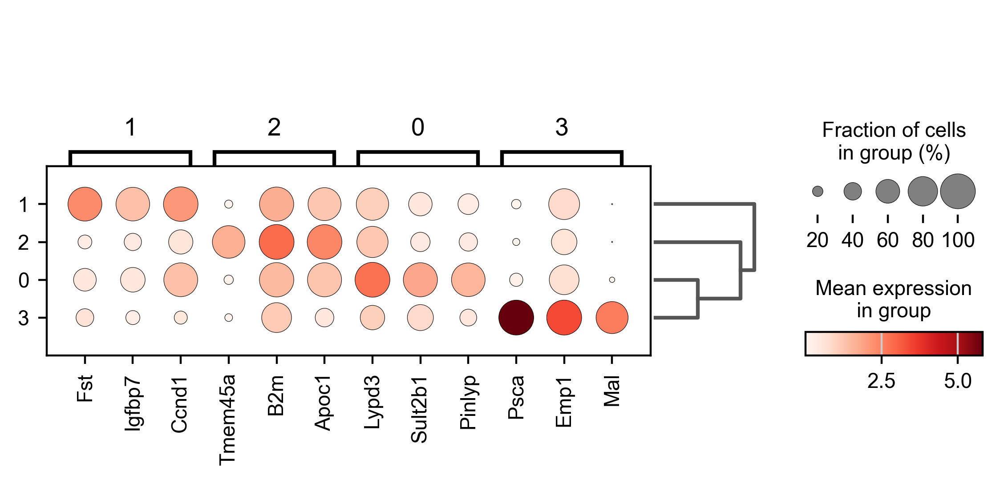

In [154]:
sc.tl.dendrogram(adata,groupby="leiden", n_pcs=40)
sc.pl.rank_genes_groups_dotplot(adata,n_genes=3)#,key="rank_genes_groups_filtered")

In [163]:
adata

AnnData object with n_obs × n_vars = 13686 × 1717
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'tissue', 'sorting', 'sample_nom', 'tx_name', 'batch_name', 'Size_Factor', 'sample', 'tissue_updated', 'tissue_updated_sorting', 'cluster', 'partition', 'cell_type', 'integrated_type_bridge', 'integrated_celltype_spike', 'chr1', 'chr2', 'chr3', 'chr4', 'chr5', 'chr6', 'chr7', 'chr8', 'chr9', 'chr10', 'chr11', 'chr12', 'chr13', 'chr14', 'chr15', 'chr16', 'chr17', 'chr18', 'chr19', 'chrMT', 'project.name', 'project.id', 'sample_name', 'sample.collection.date', 'Gladstone.Sample.ID', 'sample.ID', 'Sample.Info', 'Genotype', 'Mouse.ID', 'Sex', 'Age', 'tissue.name', 'tissue.class', 'FACS', 'DMBA.TPA', 'Tamoxifen', 'Chemo', 'Location', 'Histology', 'In.vitro.morphology', 'Batch', 'i7', 'i5..reverse.complement.', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes

In [155]:
sigFile = "geneSigs/simpLUADcs.csv"
sigGenes = pd.read_csv(sigFile).dropna()
hpcs = sigGenes["HPCS"]

In [156]:
sc.tl.score_genes(adata, hpcs, score_name="HPCS_score")

computing score 'HPCS_score'
    finished: added
    'HPCS_score', score of gene set (adata.obs).
    1086 total control genes are used. (0:00:00)


/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/jor4008/programs/miniconda3/envs/scsarc/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


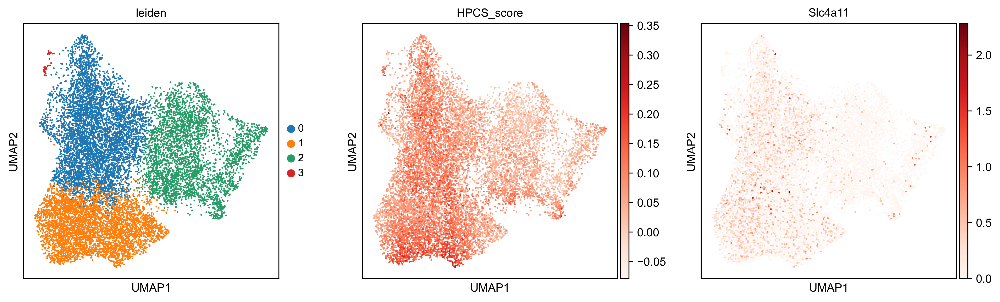

In [158]:
sc.pl.umap(adata, color=["leiden","HPCS_score","Slc4a11"],ncols=3, cmap="Reds")

In [160]:
resultsFile

'write/mouse_Skin_GSE261766_Pap.h5ad'

In [161]:
adata.write(resultsFile)
adata

AnnData object with n_obs × n_vars = 13686 × 1717
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'percent.mt', 'tissue', 'sorting', 'sample_nom', 'tx_name', 'batch_name', 'Size_Factor', 'sample', 'tissue_updated', 'tissue_updated_sorting', 'cluster', 'partition', 'cell_type', 'integrated_type_bridge', 'integrated_celltype_spike', 'chr1', 'chr2', 'chr3', 'chr4', 'chr5', 'chr6', 'chr7', 'chr8', 'chr9', 'chr10', 'chr11', 'chr12', 'chr13', 'chr14', 'chr15', 'chr16', 'chr17', 'chr18', 'chr19', 'chrMT', 'project.name', 'project.id', 'sample_name', 'sample.collection.date', 'Gladstone.Sample.ID', 'sample.ID', 'Sample.Info', 'Genotype', 'Mouse.ID', 'Sex', 'Age', 'tissue.name', 'tissue.class', 'FACS', 'DMBA.TPA', 'Tamoxifen', 'Chemo', 'Location', 'Histology', 'In.vitro.morphology', 'Batch', 'i7', 'i5..reverse.complement.', 'n_genes', 'n_genes_by_counts', 'total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes